# Analyses with FIRE-2 G2-G3 merger

In [1]:
from IPython.display import HTML
HTML('''<script>
  function code_toggle() {
    if (code_shown){
      $('div.input').hide('500');
      $('#toggleButton').val('Show Code')
    } else {
      $('div.input').show('500');
      $('#toggleButton').val('Hide Code')
    }
    code_shown = !code_shown
  }

  $( document ).ready(function(){
    code_shown=false;
    $('div.input').hide()
  });
</script>
<form action="javascript:code_toggle()"><input type="submit" id="toggleButton" value="Show Code"></form>''')

In [2]:
%matplotlib widget
# import matplotlib as mpl
# mpl.rcParams.update(mpl.rcParamsDefault)

In [2]:
# import packages
from astropy.utils import data
from radio_beam import Beam
from astropy import units as u
import time
import numpy as np
import matplotlib.pyplot as plt
import math
from astropy.io import fits
from astropy.wcs import WCS
import pandas as pd
from scipy.stats.stats import pearsonr
from matplotlib import rcParams
import seaborn as sns
from scipy import stats
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.ndimage import gaussian_filter
import matplotlib as mpl
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
from math import log10, floor
import pickle
from astropy.table import Table
from statsmodels.stats.weightstats import DescrStatsW
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.ticker as mtick
from astropy.coordinates import SkyCoord

# import functions
def count_time(stop, start):
    '''
    Convert the time difference into human readable form. 
    '''
    dure=stop-start
    m,s=divmod(dure,60)
    h,m=divmod(m,60)
    print("%d:%02d:%02d" %(h, m, s))

    return

def make_mom0(dataCubes, pixsize=100, value=1e10):
    '''
    ------
    Parameters
    dataCubes: 3d numpy array
        3D numpy array to make moment maps
    pixsize: float
        Size of each pixel in pc
    value: float
        pixel unit in solar mass
    '''
    mom0 = np.nansum(dataCubes, axis=2) * value / pixsize**2

    return mom0

def make_mom1(dataCubes, vel_1d):
    '''
    ------
    Parameters
    dataCubes: 3d numpy array
        3D numpy array to make moment maps
    vel_1d: 1d numpy array
        1D array of velocity values corresponding to the 3rd
        axis of the dataCubes.
    '''
    vel_3d = np.full(np.shape(dataCubes),fill_value=np.nan)
    vel_3d[:] = vel_1d
    mom1 = np.nansum(vel_3d*dataCubes,axis=2) / np.nansum(dataCubes,axis=2)

    return mom1

def make_mom2(dataCubes, vel_1d):
    '''
    ------
    Parameters
    dataCubes: 3d numpy array
        3D numpy array to make moment maps
    vel_1d: 1d numpy array
        1D array of velocity values corresponding to the 3rd
        axis of the dataCubes.
    '''
    vel_3d = np.full(np.shape(dataCubes),fill_value=np.nan)
    vel_3d[:] = vel_1d
    mom1 = np.nansum(vel_3d*dataCubes,axis=2) / np.nansum(dataCubes,axis=2)

    mom1_3d = np.repeat(mom1[:,:,np.newaxis], len(vel_1d), axis=2)
    vel_diff = vel_3d - mom1_3d
    mom2 = np.sqrt(np.nansum(vel_diff**2*dataCubes,axis=2) / np.nansum(dataCubes,axis=2))

    return mom2

def make_Tpeak(dataCubes, pixsize=100, value=1e10, alphaCO=4.3, ratio=0.7, deltaV=2):
    '''
    ------
    Parameters
    dataCubes: 3d numpy array
        3D numpy array to make moment maps
    pixsize: float
        Size of each pixel in pc
    value: float
        pixel unit in solarmass
    alphaCO: float
        CO-H2 conversion factor
    ratio: float
        CO 2-1/1-0 ratio
    deltaV : float
        Velocity resolution per channel
    '''
    mom8 = np.nanmax(dataCubes, axis=2)*value/pixsize**2
    Tpeak = mom8 / alphaCO / deltaV * ratio
    Tpeak[np.where(np.isnan(Tpeak))] = 0

    return Tpeak

def round_sig(x, sig=2):
    '''
    round the x to certain significant figures
    '''
    return round(x, sig-int(floor(log10(abs(x))))-1)


def density_contour(
        x, y, weights=None, xlim=None, ylim=None,
        overscan=(0.1, 0.1), logbin=(0.02, 0.02), smooth_nbin=(3, 3),
        levels=(0.393, 0.865, 0.989), alphas=(0.75, 0.50, 0.25),
        color='k', contour_type='contourf', ax=None, **contourkw):
    """
    Generate data density contours (in log-log space).
    Parameters
    ----------
    x, y : array_like
        x & y coordinates of the data points
    weights : array_like, optional
        Statistical weight on each data point.
        If None (default), uniform weight is applied.
        If not None, this should be an array of weights,
        with its shape matching `x` and `y`.
    xlim, ylim : array_like, optional
        Range to calculate and generate contour.
        Default is to use a range wider than the data range
        by a factor of F on both sides, where F is specified by
        the keyword 'overscan'.
    overscan : array_like (length=2), optional
        Factor by which 'xlim' and 'ylim' are wider than
        the data range on both sides. Default is 0.1 dex wider,
        meaning that xlim = (Min(x) / 10**0.1, Max(x) * 10**0.1),
        and the same case for ylim.
    logbin : array_like (length=2), optional
        Bin widths (in dex) used for generating the 2D histogram.
        Usually the default value (0.02 dex) is enough, but it
        might need to be higher for complex distribution shape.
    smooth_nbin : array_like (length=2), optional
        Number of bins to smooth over along x & y direction.
        To be passed to `~scipy.ndimage.gaussian_filter`
    levels : array_like, optional
        Contour levels to be plotted, specified as levels in CDF.
        By default levels=(0.393, 0.865, 0.989), which corresponds
        to the integral of a 2D normal distribution within 1-sigma,
        2-sigma, and 3-sigma range (i.e., Mahalanobis distance).
        Note that for an N-level contour plot, 'levels' must have
        length=N+1, and its leading element must be 0.
    alphas : array_like, optional
        Transparancy of the contours. Default: (0.75, 0.50, 0.25)
    color : mpl color, optional
        Base color of the contours. Default: 'k'
    contour_type : {'contour', 'contourf'}, optional
        Contour drawing function to call
    ax : `~matplotlib.axes.Axes` object, optional
        The Axes object to plot contours in.
    **contourkw
        Keywords to be passed to the contour drawing function
        (see keyword "contour_type")
    Returns
    -------
    ax : `~matplotlib.axes.Axes` object
        The Axes object in which contours are plotted.
    """

    if xlim is None:
        xlim = (10**(np.nanmin(np.log10(x))-overscan[0]),
                10**(np.nanmax(np.log10(x))+overscan[0]))
    if ylim is None:
        ylim = (10**(np.nanmin(np.log10(y))-overscan[1]),
                10**(np.nanmax(np.log10(y))+overscan[1]))

    if ax is None:
        ax = plt.subplot(111)
        ax.set_xlim(xlim)
        ax.set_ylim(ylim)

    # force to change to log-log scale
    ax.set_xscale('log')
    ax.set_yscale('log')

    # generate 2D histogram
    lxedges = np.arange(
        np.log10(xlim)[0], np.log10(xlim)[1]+logbin[0], logbin[0])
    lyedges = np.arange(
        np.log10(ylim)[0], np.log10(ylim)[1]+logbin[1], logbin[1])
    if weights is None:
        hist, lxedges, lyedges = np.histogram2d(
            np.log10(x), np.log10(y),
            bins=[lxedges, lyedges])
    else:
        hist, lxedges, lyedges = np.histogram2d(
            np.log10(x), np.log10(y), weights=weights,
            bins=[lxedges, lyedges])
    xmids = 10**(lxedges[:-1] + 0.5*logbin[0])
    ymids = 10**(lyedges[:-1] + 0.5*logbin[1])

    # smooth 2D histogram
    pdf = gaussian_filter(hist, smooth_nbin).T

    # calculate cumulative density distribution (CDF)
    cdf = np.zeros_like(pdf).ravel()
    for i, density in enumerate(pdf.ravel()):
        cdf[i] = pdf[pdf >= density].sum()
    cdf = (cdf/cdf.max()).reshape(pdf.shape)

    # plot contourf
    if contour_type == 'contour':
        contourfunc = ax.contour
        contourlevels = levels
    elif contour_type == 'contourf':
        contourfunc = ax.contourf
        contourlevels = np.hstack([[0], levels])
    else:
        raise ValueError(
            "'contour_type' should be either 'contour' or 'contourf'")
    contourfunc(
        xmids, ymids, cdf, contourlevels,
        colors=[mpl.colors.to_rgba(color, a) for a in alphas],
        **contourkw)

    return ax

In [3]:
# directories
npzDir = '../FIRE_GalSep/'
fitsDir = '../data/e2/'
logDir = '../data/'
picDir = '../pictures/'
figDir = '../Figures/'

tex_textwidth = 14.2
# plt.style.use('seaborn-paper')
# plt.rcParams.update({'font.size': 12})
# plt.rcParams['text.usetex'] = True
# plt.rcParams['font.family'] = 'serif'
# plt.rcParams['font.serif'] = [
#     'Times', 'Times New Roman', 'DejaVu Serif', 'serif']
# plt.rcParams['font.sans-serif'] = [
#     'Helvetica', 'Arial', 'DejaVu Sans', 'sans-serif']
# plt.rcParams['font.monospace'] = [
#     'Terminal', 'monospace']
# plt.rcParams.update(rcParams)

In [10]:
# Load the literature data

# import the literature data from Sun+2020
filename= logDir+'Sun_2020_GMC.txt'
skiprows=28
table=pd.read_csv(filename,header=None,sep=r"\s+",skiprows=skiprows,engine='python')
table_90pc=table.loc[(table[1]==90)]
table_center = table.loc[(table[3]==1)]
table_offcenter = table.loc[(table[3]==0)]
# read the galaxy type
filename = logDir+'Sun_2020_galaxies.txt'
skiprows = 47
table_galaxy = pd.read_fwf(filename, colspecs='infer', header=None, skiprows=skiprows,engine='python')
galaxy_barred = np.array(table_galaxy[0].loc[(table_galaxy[2]=='Y')])
galaxy_unbarred = np.array(table_galaxy[0].loc[(table_galaxy[2]=='N')])
# classify center into bared and unbarred. 
table_center_barred = table_center.loc[table_center[0].isin(galaxy_barred)]
table_center_unbarred = table_center.loc[table_center[0].isin(galaxy_unbarred)]

# import the literature data from Sun+2018 for Antennae, M31 and M33.
filename = logDir+'Sun_2018_GMCs.txt'
table2 = pd.read_csv(filename,header=None,sep=r"\s+",skiprows=skiprows,engine='python')
table_120pc = table2.loc[(table2[1]==120)]
# select Antennae overlap regions
table_antennae = table_120pc.loc[(table_120pc[0]=='Antennae')]
# select M31 and M33. 
table_M31 = table_120pc.loc[(table_120pc[0]=='M31')]
table_M33 = table_120pc.loc[(table_120pc[0]=='M33')]
table_M3 = pd.concat([table_M31,table_M33])

# import the global properties of the PHANGS galaxies
filename = logDir+'PHANGS_Mgas.txt'
skiprows = 46
colnames = ['Galaxy', 'f_Galaxy', 'log_Mstar', 'f_log_Mstar', 'r25', 'Re', 'lstar', 'log_SFR', 'f_log_SFR', 
          'l_logLCO', 'logLCO', 'Corr', 'logMHI']
table = pd.read_fwf(filename, colspecs='infer',names=colnames, skiprows=skiprows, engine='python')
table['Galaxy'] = table['Galaxy'].str.replace(' ', '')
table_Sun = table[table['Galaxy'].isin(table_galaxy[0])]
log_Mstar = table_Sun['log_Mstar']
log_LCO21 = table_Sun['logLCO']
log_MHI = table_Sun['logMHI']
# total molecular gas
Mmol = 4.3 * 10**log_LCO21 / 0.7
Mstar = 10**log_Mstar
fraction= Mmol / Mstar
# include the HI as well
MHI = 10**log_MHI
Mgas = Mmol+MHI
gas_fraction = Mgas / Mstar

percentages = [0, 20, 40, 60, 80, 100]
bins = [np.percentile(Mstar, percent) for percent in percentages]
digitized = np.digitize(Mstar, bins)
Mstar_med = [np.nanmedian(Mstar[digitized==i]) for i in range(1, len(bins))]
fraction_med = [np.nanmedian(fraction[digitized==i]) for i in range(1, len(bins))]
gas_fraction_med = [np.nanmedian(gas_fraction[digitized==i]) for i in range(1, len(bins))]
Mmol_med = np.array(Mstar_med) * np.array(fraction_med)
Mgas_med = np.array(Mstar_med) * np.array(gas_fraction_med)
gas_fraction_1qua = np.array([np.percentile(gas_fraction[digitized == i], 25) for i in range(1, len(bins))])
gas_fraction_3qua = np.array([np.percentile(gas_fraction[digitized == i], 75) for i in range(1, len(bins))])

# import the global properties of xGASS sample
filename = logDir + 'Catinella_2018_HI_H2.xlsx'
table_xGASS = pd.read_excel(filename)
Mstar_xGASS = 10**(table_xGASS['<x>'].astype('float'))
fgas_xGASS = 10**(table_xGASS['fgas_med'].astype('float'))
Mgas_xGASS = Mstar_xGASS * fgas_xGASS

filename2 = logDir + 'Saintonge_2017_H2.txt'
table_xCOLDGASS = pd.read_csv(filename2, sep="\t", header=0, skiprows=list(range(6))+[7,8], nrows=10)
Mstar_xCOLDGASS = 10**table_xCOLDGASS['$\\langle x\\rangle $.3']
fmol_temp = table_xCOLDGASS['$\\langle \\mathrm{log}\\,{f}_{{{\\rm{H}}}_{2}}\\rangle $.1']
fmol_temp = fmol_temp.str.split(expand=True)
fmol_xCOLDGASS = 10**(fmol_temp[0].astype(float))
fmolErr_xCOLDGASS = 2.303*fmol_xCOLDGASS*(fmol_temp[2].astype(float))
Mmol_xCOLDGASS = fmol_xCOLDGASS * Mstar_xCOLDGASS

# M31 properties (Nieten et al.2006; Sick et al. 2014)
M31_Mmol = 3.6e8
M31_Mgas = 5.2e9
M31_Mstar = 8.8e10

# Import pixel analyses on Antennae and NGC 3256
filename = logDir+'Antennae_Brunetti_pix.ecsv'
table_antennae = Table.read(filename)
table_ant = table_antennae.to_pandas()
table_ant_90pc = table_ant.loc[table_ant['beam_fwhm']==90]
# For NGC 3256
filename = logDir+'NGC3256_Brunetti_pix.ecsv'
table_3256 = (Table.read(filename)).to_pandas()
table_3256_80pc = table_3256.loc[table_3256['beam_fwhm']==80]

#### Check the south nucleus distance

In [6]:
np.max(table_3256_80pc['south_nucleus_distance'])
Table.read(filename)['south_nucleus_distance']
table_3256_80pc.columns

Index(['beam_fwhm', 'ra', 'dec', 'surface_density', 'velocity_dispersion',
       'peak_brightness_temperature', 'virial_parameter', 'turbulent_pressure',
       'scale_height', 'free_fall_time', 'external_surface_density', 'mass',
       'north_nucleus_distance', 'south_nucleus_distance', 'in_north_jet',
       'in_south_jet', 'in_west_exclusion'],
      dtype='object')

In [7]:
ra_south = 15*(10+27/60+51.22/3600); dec_south = -(43+54/60+19.2/3600)
south_center = SkyCoord(ra=ra_south*u.degree, dec=dec_south*u.degree)
GMC_cats = SkyCoord(ra=table_3256_80pc['ra']*u.deg,dec=table_3256_80pc['dec']*u.deg)
seps = south_center.separation(GMC_cats)
south_dists = 4.85*44*seps.arcsec/1000

# test
# np.max(south_dists)/np.cos(75/180*3.14)
# np.max(table_3256_80pc['south_nucleus_distance'])*np.cos(75/180*3.14)
# np.where(table_3256_80pc['south_nucleus_distance']>200)

In [8]:
np.max(table_3256_80pc['south_nucleus_distance'])

241.38185069160332

## The isolated galaxy

In [9]:
# make the moment maps
def make_moments(fitsfile, vel):
    data = fits.open(fitsfile)[0].data
    data[np.where(data==0)] = np.nan
    mom0 = make_mom0(data)
    mom1 = make_mom1(data, vel)
    mom2 = make_mom2(data, vel)
    return data, mom0, mom1, mom2

def set_threshold(data, mom0, mom2):
    
    counts = np.count_nonzero(~np.isnan(data), axis=2)
    mom0_filter = np.copy(mom0)
    mom2_filter = np.copy(mom2)
    mom0_filter[np.where(mom0<1)] = np.nan
    mom2_filter[np.where(counts<2)] = np.nan
    mask = np.ma.mask_or(np.isnan(mom0_filter.flatten()), np.isnan(mom2_filter.flatten()))
    m0 = mom0.flatten()[np.where(~mask)]
    m2 = mom2.flatten()[np.where(~mask)]
    return m0, m2

vel = np.arange(-500, 500, 2)

# load data and information for G2 galaxy
fitsfile_i2 = 'losvd_FIRE2_i2_025_gas_pa30__32.fits'
data_i2, mom0_i2, mom1_i2, mom2_i2 = make_moments(fitsfile_i2, vel)
m0_i2, m2_i2 = set_threshold(data_i2, mom0_i2, mom2_i2)

# Loat data and information for G3 galaxy
fitsfile_i3 = 'losvd_FIRE2_i3_025_gas_pa30__32.fits'
data_i3, mom0_i3, mom1_i3, mom2_i3 = make_moments(fitsfile_i3, vel)
m0_i3, m2_i3 = set_threshold(data_i3, mom0_i3, mom2_i3)

# load the data and information for G3 galaxy with inclination of 60 degrees
fitsfile_i3_60 = 'losvd_FIRE2_i3_025_gas_pa60__32.fits'
data_i3_60, mom0_i3_60, mom1_i3_60, mom2_i3_60 = make_moments(fitsfile_i3_60, vel)
m0_i3_60, m2_i3_60 = set_threshold(data_i3_60, mom0_i3_60, mom2_i3_60)

# load the data and information for G3 galaxy with inclination of 80 degrees
fitsfile_i3_80 = 'losvd_FIRE2_i3_025_gas_pa80__32.fits'
data_i3_80, mom0_i3_80, mom1_i3_80, mom2_i3_80 = make_moments(fitsfile_i3_80, vel)
m0_i3_80, m2_i3_80 = set_threshold(data_i3_80, mom0_i3_80, mom2_i3_80)

# calculate the G3 mass weighted surface density for this snapshot
wq = DescrStatsW(data=m0_i3, weights=m0_i3)
surf_median = wq.quantile(probs=[0.5], return_pandas=False)
print('median surface density: '+str(round(surf_median[0],2)))
wq = DescrStatsW(data=m2_i3, weights=m0_i3)
vdep_median = wq.quantile(probs=[0.5], return_pandas=False)
print('median velocity dispersion: '+str(round(vdep_median[0],2)))
aVir = 5.77 * m2_i3**2 * m0_i3**(-1) * (50/40)**(-1)
wq = DescrStatsW(data=aVir, weights=m0_i3)
aVir_median = wq.quantile(probs=[0.5], return_pandas=False)
print('median virial parameter: '+str(round(aVir_median[0],2)))

C:\Users\haohe\AppData\Local\Temp\ipykernel_20552\3363916259.py:68: RuntimeWarning: invalid value encountered in true_divide
  mom1 = np.nansum(vel_3d*dataCubes,axis=2) / np.nansum(dataCubes,axis=2)
C:\Users\haohe\AppData\Local\Temp\ipykernel_20552\3363916259.py:84: RuntimeWarning: invalid value encountered in true_divide
  mom1 = np.nansum(vel_3d*dataCubes,axis=2) / np.nansum(dataCubes,axis=2)
C:\Users\haohe\AppData\Local\Temp\ipykernel_20552\3363916259.py:88: RuntimeWarning: invalid value encountered in true_divide
  mom2 = np.sqrt(np.nansum(vel_diff**2*dataCubes,axis=2) / np.nansum(dataCubes,axis=2))


median surface density: 19.16
median velocity dispersion: 3.8
median virial parameter: 3.37


We plot the velocity dispersion version gas surface density for the G2 and G3 galaxies, as shown in the following plot. As we can see, the G2 and G3 galaxies have the similar gas surface density and velocity dispersion. They generally follow the trend observed for PHANGS galaxies. However, it seems that both of galaxies have gas at lower surface density end. One of the reasons are that the simulated galaxies might not be barred galaxy. However, as this plot show, the gas surface density of the simulation galaxy is still lower than that of unbarred galaxies in PHANGS sample. 

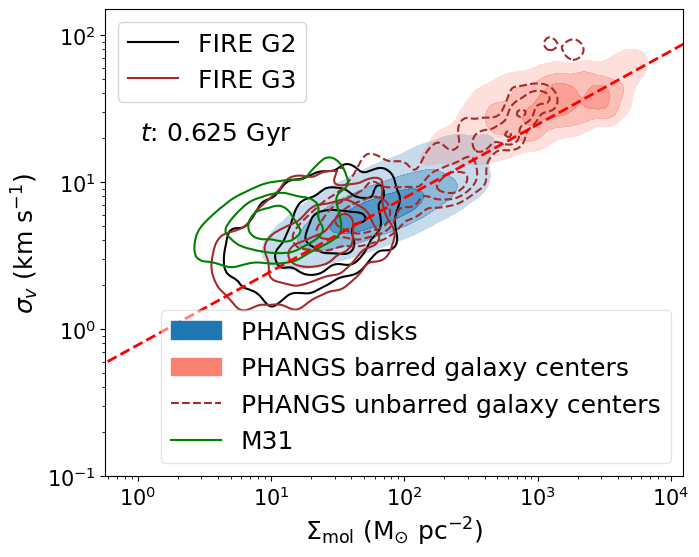

In [10]:
%matplotlib inline
levels = [0.2,0.5,0.8]

fig = plt.figure(figsize=(0.5*tex_textwidth,0.5*0.8*tex_textwidth)) # paper
# fig = plt.figure(figsize=(7, 4)) # abstract
ax = plt.subplot(111)
plt.xscale('log')
plt.yscale('log')

plt.xlabel('$\Sigma_{\mathrm{mol}}$ (M$_{\odot}$ pc$^{-2}$)',fontsize=18)
plt.ylabel(r'$\sigma_v$ (km s$^{-1}$)',fontsize=18)
plt.tick_params(labelsize=15)

# Draw the scatter and contour plot for simulation 
density_contour(m0_i2, m2_i2, weights=m0_i2, levels=levels, ax=ax, color='black',
                contour_type='contour',alphas=(1,1,1))
density_contour(m0_i3, m2_i3, weights=m0_i3, levels=levels, ax=ax, color='brown',
                contour_type='contour',alphas=(1,1,1))
plt.ylim(bottom=0.1, top=150)

# label the time for the plot
ax.annotate('$t$: 0.625 Gyr', (0.06,0.72), xycoords='axes fraction', fontsize=18)

# Draw the contour plot for Sun+2020 data
density_contour(table_offcenter[7], table_offcenter[8], weights=table_offcenter[7],levels=levels,
                ax=ax, color='tab:blue')
density_contour(table_center_barred[7], table_center_barred[8], weights=table_center_barred[7], levels=levels,
                ax=ax, color='salmon')
density_contour(table_center_unbarred[7], table_center_unbarred[8], weights=table_center_unbarred[7],
                levels=levels,
                ax=ax, color='brown',
                contour_type='contour', linestyles='dashed',alphas=(1,1,1))
# Draw the contour plot for Sun+2018 data
# density_contour(table_antennae[3], table_antennae[4], weights=table_antennae[3], levels=levels,
#                     ax=ax, contour_type='contour', alphas=(1,1,1), color='red')
density_contour(table_M31[3], table_M31[4], weights=table_M31[3], levels=levels,
                ax=ax, contour_type='contour', alphas=(1,1,1), color='green')

# Draw the virial parameter
ax.set_xlim(); ax.set_ylim()
Sigmol_theory = 10**np.linspace(-1,5,5)
vdep_theory = np.sqrt(Sigmol_theory * 3.1 / 5.77 * (45/40))
plt.plot(Sigmol_theory, vdep_theory, linestyle='--',linewidth=2,color='red')

# label the legend
line_simul2 = mlines.Line2D([],[],color='black', linestyle='solid', label='FIRE G2')
line_simul3 = mlines.Line2D([],[],color='brown', linestyle='solid', label='FIRE G3')
patch1 = mpatches.Patch(color='tab:blue', label='PHANGS disks')
patch2 = mpatches.Patch(color='salmon', label='PHANGS barred galaxy centers')
line=mlines.Line2D([], [], color='brown', linestyle='dashed', label='PHANGS unbarred galaxy centers')
# line2=mlines.Line2D([], [], color='red', linestyle='solid', label='Antennae overlap region')
line3=mlines.Line2D([], [], color='green', linestyle='solid', label='M31')
legend = plt.legend(handles=[line_simul2, line_simul3], loc='upper left',fontsize=18) # fontsize=10
legend1 = plt.legend(handles=[patch1, patch2, line, line3], loc='lower right',fontsize=18, framealpha=0.5) # fontsize=10
plt.gca().add_artist(legend)
fig.tight_layout()
plt.savefig('../Figures/G2G3_iso_Sigmol_vdep.pdf', bbox_inches='tight')

Another issue might be the inclination angle. If we view the galaxy from edge-on, we would have higher gas surface density. In previous plot, we chose G2 and G3 galaxy with incliation angle of 30 degree. In the following plot, we plot 3 different inclination angles for G3 galaxy. As we can see, the contour for the G3 galaxies with 3 different inclinations kind of overlap with each other. The only exception is G3 galaxy with 80 degrees with some exremely high gas surface density of 200 solar mass per parsec square. This is probably due to the high extinction

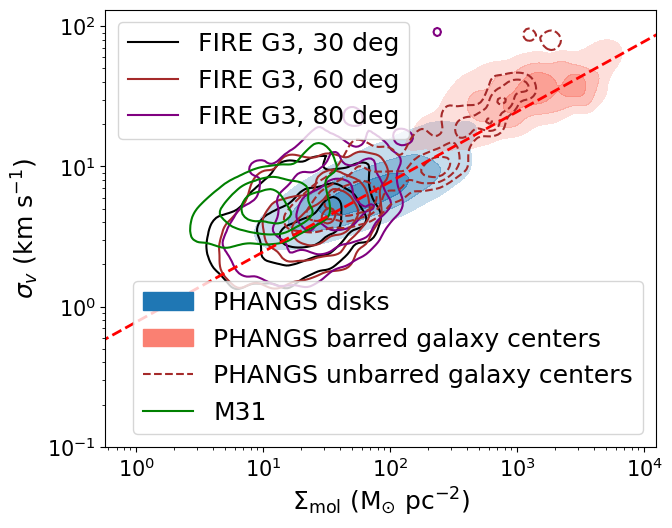

In [11]:
levels = [0.2,0.5,0.8]

fig = plt.figure(figsize=(0.5*tex_textwidth,0.5*0.8*tex_textwidth))
# fig = plt.figure(figsize=(10,7))
ax = plt.subplot(111)
plt.xscale('log')
plt.yscale('log')

plt.xlabel('$\Sigma_{\mathrm{mol}}$ (M$_{\odot}$ pc$^{-2}$)',fontsize=18)
plt.ylabel(r'$\sigma_v$ (km s$^{-1}$)',fontsize=18)
plt.tick_params(labelsize=15)

# Draw the scatter and contour plot for simulation 
density_contour(m0_i3, m2_i3, weights=m0_i3, levels=levels, ax=ax, color='black',
                contour_type='contour',alphas=(1,1,1))
density_contour(m0_i3_60, m2_i3_60, weights=m0_i3_60, levels=levels, ax=ax, color='brown',
                contour_type='contour',alphas=(1,1,1))
density_contour(m0_i3_80, m2_i3_80, weights=m0_i3_80, levels=levels, ax=ax, color='purple',
                contour_type='contour',alphas=(1,1,1))
plt.ylim(bottom=0.1)

# Draw the contour plot for Sun+2020 data
density_contour(table_offcenter[7], table_offcenter[8], weights=table_offcenter[7],levels=levels,
                ax=ax, color='tab:blue')
density_contour(table_center_barred[7], table_center_barred[8], weights=table_center_barred[7], levels=levels,
                ax=ax, color='salmon')
density_contour(table_center_unbarred[7], table_center_unbarred[8], weights=table_center_unbarred[7],
                levels=levels,
                ax=ax, color='brown',
                contour_type='contour', linestyles='dashed',alphas=(1,1,1))
# Draw the contour plot for Sun+2018 data
# density_contour(table_antennae[3], table_antennae[4], weights=table_antennae[3], levels=levels,
#                     ax=ax, contour_type='contour', alphas=(1,1,1), color='red')
density_contour(table_M31[3], table_M31[4], weights=table_M31[3], levels=levels,
                ax=ax, contour_type='contour', alphas=(1,1,1), color='green')

# Draw the virial parameter
ax.set_xlim(); ax.set_ylim()
Sigmol_theory = 10**np.linspace(-1,5,5)
vdep_theory = np.sqrt(Sigmol_theory * 3.1 / 5.77 * (45/40))
plt.plot(Sigmol_theory, vdep_theory, linestyle='--',linewidth=2,color='red')

# label the legend
line_simul_30 = mlines.Line2D([],[],color='black', linestyle='solid', label='FIRE G3, 30 deg')
line_simul_60 = mlines.Line2D([],[],color='brown', linestyle='solid', label='FIRE G3, 60 deg')
line_simul_80 = mlines.Line2D([],[],color='purple', linestyle='solid', label='FIRE G3, 80 deg')
patch1 = mpatches.Patch(color='tab:blue', label='PHANGS disks')
patch2 = mpatches.Patch(color='salmon', label='PHANGS barred galaxy centers')
line=mlines.Line2D([], [], color='brown', linestyle='dashed', label='PHANGS unbarred galaxy centers')
# line2=mlines.Line2D([], [], color='red', linestyle='solid', label='Antennae overlap region')
line3=mlines.Line2D([], [], color='green', linestyle='solid', label='M31')
legend = plt.legend(handles=[line_simul_30, line_simul_60, line_simul_80], loc='upper left',fontsize=18)
legend1 = plt.legend(handles=[patch1, patch2, line, line3], loc='lower right', fontsize=18)
plt.gca().add_artist(legend)
plt.savefig('../Figures/G3_incls_Sigmol_vdep.pdf', bbox_inches='tight', pad_inches=0.2)

Another possibility we suspect is there is not as much gas in those two galxies as in PHANGS galaxies to form high-surface density cloud. We can compare the total molecular gas mass and stellar mass of the simulation galaxy with that of PHANGS galaxies. The following plot shows the gas fraction (molecular gas mass divided by stellar mass) versus the total stellar mass. We can see our G2 and G3 galaxies all have lower gas fraction compared to the PHANGS galaxies. 

['mgas', 'mgas_cool', 'mgas_cold', 'mstar', 'mstar_young']


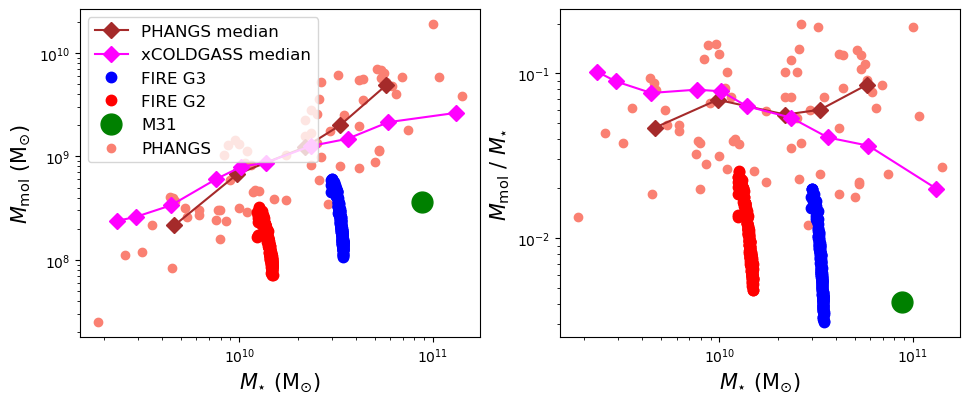

In [12]:
# Mmol_G2 = np.nansum(data_i2)*1e10
# Mmol_G3 = np.nansum(data_i3)*1e10

# Mstar_G2 = 1.2e10
# Mstar_G3 = 3e10
# # Load the molecular gas mass for G2 and G3. 
# print("G2 mol fraction: "+str(Mmol_G2/Mstar_G2))
# print("G3 mol fraction: "+str(Mmol_G3/Mstar_G3))

# Molecular gas mass and star formation
filename = '../data/FIRE_Merger_Evolution_i2.npz'
G2_iso = np.load(filename)
print(G2_iso.files)
filename = '../data/FIRE_Merger_Evolution_i3.npz'
G3_iso = np.load(filename)

# plt.rcParams['text.latex.preamble'] = [r"\usepackage{lmodern}"]
# # rcParams['mathtext.default']='regular'
# params = {'text.usetex': True,
#           'font.size': 12,
#           'font.family': 'lmodern',
#          }
# plt.rcParams.update(params)

fig = plt.figure(figsize=(0.8*tex_textwidth, 0.3*tex_textwidth))
# fig = plt.figure(figsize=(12,5))
ax0 = plt.subplot(121)
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$M_{\star}$ (M$_{\odot}$)', fontsize=15)
plt.ylabel(r'$M_{\mathrm{mol}}$ (M$_{\odot}$)', fontsize=15)
ax0.scatter(Mstar, Mmol, color='salmon', label='PHANGS')
ax0.plot(Mstar_med, Mmol_med, marker='D', markersize=8, color='brown', label='PHANGS median')
ax0.plot(Mstar_xCOLDGASS, Mmol_xCOLDGASS, marker='D', markersize=8, color='magenta', label='xCOLDGASS median')
# ax0.plot(Mstar_G3, Mmol_G3, marker='*', markersize=20, linestyle='', color='blue')
# ax0.plot(Mstar_G2, Mmol_G2, marker='*', markersize=20, linestyle='', color='red')
ax0.plot(G3_iso['mstar']*1e10, G3_iso['mgas_cold']*1e10, marker='.', markersize=15, linestyle='', color='blue', label='FIRE G3')
ax0.plot(G2_iso['mstar']*1e10, G2_iso['mgas_cold']*1e10, marker='.', markersize=15, linestyle='', color='red', label='FIRE G2')
ax0.plot(M31_Mstar, M31_Mmol , marker='o', markersize=15, linestyle='', color='green', label='M31')
ax0.legend(fontsize=12, loc='upper left')

ax1 = plt.subplot(122)
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$M_{\star}$ (M$_{\odot}$)', fontsize=15)
plt.ylabel(r'$M_{\mathrm{mol}}$ / $M_{\star}$', fontsize=15)
# simulated galaxies
ax1.plot(G2_iso['mstar']*1e10, G2_iso['mgas_cold']/G2_iso['mstar'], marker='.', markersize=15, linestyle='', color='red')
ax1.plot(G3_iso['mstar']*1e10, G3_iso['mgas_cold']/G3_iso['mstar'], marker='.', markersize=15, linestyle='', color='blue')
# observed galaxies
ax1.scatter(Mstar, fraction, color='salmon')
ax1.plot(Mstar_med, fraction_med, marker='D', markersize=8, color='brown')
ax1.plot(Mstar_xCOLDGASS, fmol_xCOLDGASS, marker='D', markersize=8, color='magenta')
ax1.plot(M31_Mstar, M31_Mmol/M31_Mstar, marker='o', markersize=15, linestyle='', color='green')

plt.savefig('../Figures/G2G3_mol_fraction.pdf',bbox_inches='tight',pad_inches=0.2)

We further explore if the small molecular gas fraction is due to the low initial total gas mass of the simulation or due to the low conversion rate from original gas to cold-dense molecular gas. Therefore, we also compare the (MHI+MH2)/Mstar of G3 and PHANGS galaxies, as shown in the following plot. We can see the cool gas fraction in simulation is also lower than the observation. Therefore, we suspect the low initial gas mass might be the cause to the low gas surface density.

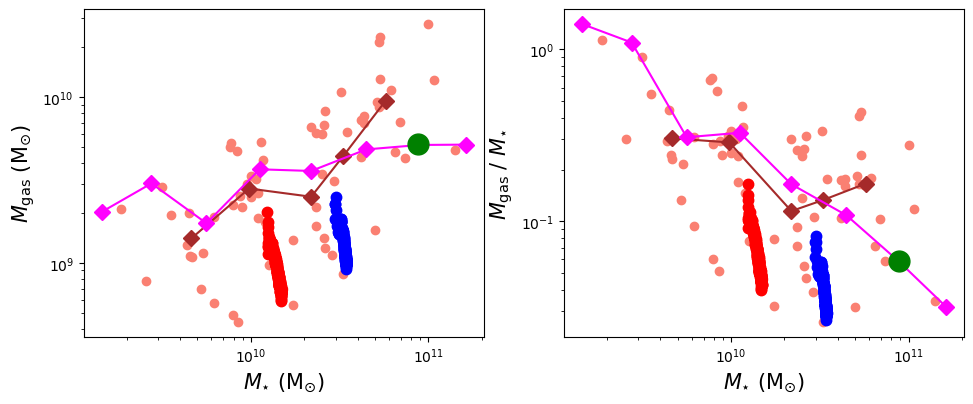

In [13]:
# Mgas_G3 = Mmol_G3 * 5
# Mgas_G2 = Mmol_G2 *5

# print("G2 gas fraction: "+str(Mgas_G2/Mstar_G2))
# print("G3 gas fraction: "+str(Mgas_G3/Mstar_G3))

# tex_fonts = {
#     # Use LaTeX to write all text
#     "text.usetex": True,
#     "font.family": "serif",
#     # Use 10pt font in plots, to match 10pt font in document
#     "axes.labelsize": 15,
#     "font.size": 15,
#     # Make the legend/label fonts a little smaller
#     "legend.fontsize": 12,
#     "xtick.labelsize": 12,
#     "ytick.labelsize": 12
# }
# plt.rcParams.update(tex_fonts)
# tex_textwidth = 14.2
fig = plt.figure(figsize=(0.8*tex_textwidth, 0.3*tex_textwidth))

# fig = plt.figure(figsize=(12,5))
ax0 = plt.subplot(121)
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$M_{\star}$ (M$_{\odot}$)', fontsize=15)
plt.ylabel(r'$M_{\mathrm{gas}}$ (M$_{\odot}$)', fontsize=15)
ax0.scatter(Mstar, Mgas, color='salmon')
ax0.plot(Mstar_med, Mgas_med, color='brown', marker='D', markersize=8)
ax0.plot(Mstar_xGASS, Mgas_xGASS, color='magenta', marker='D', markersize=8)
# ax0.plot(Mstar_G3, Mgas_G3, marker='*', markersize=20, linestyle='', color='blue')
# ax0.plot(Mstar_G2, Mgas_G2, marker='*', markersize=20, linestyle='', color='red')
ax0.plot(G3_iso['mstar']*1e10, (G3_iso['mgas_cool']+G3_iso['mgas_cold'])*1e10, marker='.', markersize=15, linestyle='', color='blue')
ax0.plot(G2_iso['mstar']*1e10, (G2_iso['mgas_cool']+G2_iso['mgas_cold'])*1e10, marker='.', markersize=15, linestyle='', color='red')
ax0.plot(M31_Mstar, M31_Mgas, marker='o', markersize=15, linestyle='', color='green')

# plt.legend(fontsize=10)
ax1 = plt.subplot(122)
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$M_{\star}$ (M$_{\odot}$)', fontsize=15)
plt.ylabel(r'$M_{\mathrm{gas}}$ / $M_{\star}$', fontsize=15)
# plot the simulated mergers
# ax1.plot(Mstar_G3, Mgas_G3/Mstar_G3, marker='*', markersize=20, linestyle='', color='blue', label='FIRE G3')
# ax1.plot(Mstar_G2, Mgas_G2/Mstar_G2, marker='*', markersize=20, linestyle='', color='red', label='FIRE G2')
ax1.plot(G2_iso['mstar']*1e10, (G2_iso['mgas_cool']+G2_iso['mgas_cold'])/G2_iso['mstar'], marker='.', markersize=15, linestyle='', color='red', label='FIRE G2')
ax1.plot(G3_iso['mstar']*1e10, (G3_iso['mgas_cool']+G3_iso['mgas_cold'])/G3_iso['mstar'], marker='.', markersize=15, linestyle='', color='blue', label='FIRE G3')
# plot the observed galaxies
ax1.scatter(Mstar, gas_fraction, label='PHANGS', color='salmon')
ax1.plot(Mstar_med, gas_fraction_med, color='brown', label='PHANGS median', marker='D', markersize=8)
ax1.plot(Mstar_xGASS, fgas_xGASS, color='magenta', label='xGASS median', marker='D', markersize=8, linestyle='-')
ax1.plot(M31_Mstar, M31_Mgas/M31_Mstar, marker='o', markersize=15, linestyle='', color='green', label='M31')
plt.savefig('../Figures/G2G3_gas_fraction.pdf',bbox_inches='tight',pad_inches=0.2)

## G2&G3 merger

We will then plot the velocity dispersion versus surface density for the G2&G3 suite. We want to see if the gas surface density in simulation is also lower than that of mergers in observation. The following animation shows the vdep vs Sigmol plot during the second SFR peak, when it's also the apocentric collision. We can see the gas surface density and velocity dispersion are significantly higher during the starburst phase than that during the quiescent phase. However, the highest gas surface density (1000 Msol/pc^2) is still lower than that of observed mergers. Furthermore, the simulation data have the higher velocity dispersion compared with observtion of the same gas surface density. In other words, the gas are more turbulent than it is observed in simulation. 

By comparing the vdep vs Sigmol plot with moment 0 map, we can also see the high surface density point corresponds to the gas in the center. This is what we expect as gas in the center should be really turbulent. In some snapshot, you can clearly see that the contour breaks into two parts. The top righ part corresponds to the gas in the center while the lower left part corresponds to the ring around the center. From 2.89 Gyr to 3.13 Gyr, we can see that gas in the center is quite concentrated. However, the largest gas surface density still has not reached 10^4 Msol/pc^2 as what we expect. The size of central gas concentration is around 1 kpc in radius, which is quite similar to observed galaxies. Therefore, the plausible explanation is there is still not enough gas to be concentrated in this small region.

In [14]:
# import the data file of merger evolution
filename=npzDir+'galsep_G2G3_e_orbit_2.npz'
data = np.load(filename)
print('Entry names:'+str(data.files))
SFRs = data['sfr']
Times = data['time']
Snapshots = data['isnap']
print(SFRs[np.where(Snapshots==520)])

Entry names:['sfr', 'mstar', 'isnap', 'd', 'time']
[1.64562953]


In [20]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 100
mpl.rcParams['animation.embed_limit'] = 2**128

# %matplotlib inline
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
from random import randint
import matplotlib.gridspec as gridspec
snapshotsPart = np.arange(520, 712, 2)

# import the data file of merger evolution
filename=npzDir+'galsep_G2G3_e_orbit_2.npz'
data = np.load(filename)
print('Entry names:'+str(data.files))
SFRs = data['sfr']
Times = data['time']
Snapshots = data['isnap']

orbit = 'e2'
incl = 'v0'

fig = plt.figure(figsize=(15,8))
spec = gridspec.GridSpec(1, 2, width_ratios=[1.5,1], wspace=0.12)
# first gridspec
gc0 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=1, subplot_spec=spec[0])
ax0 = fig.add_subplot(gc0[0])
# second gridspec
gc1 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=2, subplot_spec=spec[1], height_ratios=[1, 4], hspace=0.1)
ax1 = fig.add_subplot(gc1[0])
ax2 = fig.add_subplot(gc1[1])

# make the animation
def animate(i):
    # plot the Sigmol versus velocity dispersion
    ax0.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'Sigmol_vdep_G2G3_e2_'+str(idNo)+'_'+str(incl)+'.png')
    ax0.imshow(image)
    ax0.set_xticks([])
    ax0.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax0.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.2, 0.82), 
                 xycoords='axes fraction', fontsize=15)
    
    # plot the SFR versus time
    ax1.clear()
    idNo = snapshotsPart[i]
    ax1.plot(Times, SFRs)
    ax1.axvline(Times[np.where(Snapshots==idNo)], color='black')
    ax1.set_xlabel('time (Gyr)', fontsize=15)
    ax1.set_ylabel(r'SFR (M$_{\odot}$ yr$^{-1}$', fontsize=15)
    ax1.axvline(2.62, linestyle='dashed', color='black')
    ax1.axvline(2.84, linestyle='dashed', color='black')
    
    # plot the moment map variation
    ax2.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'G2G3_e2_mom0_'+str(idNo)+'_'+str(incl)+'.png')
    ax2.imshow(image)
    ax2.set_xticks([])
    ax2.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax2.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.16, 0.82), 
                 xycoords='axes fraction', fontsize=15)

animate(0)
plt.savefig('../Figures/G2G3_e2_v0_520.pdf', bbox_inches='tight', pad_inches=0.2)
animate(12)
# animate(33)    
plt.savefig('../Figures/G2G3_e2_v0_544.pdf', bbox_inches='tight', pad_inches=0.2)
anim = FuncAnimation(fig, animate, frames=96, interval=100, repeat=False)
plt.close()
from IPython.display import HTML
anim_html = HTML(anim.to_jshtml())
display(anim_html)
with open(figDir+'G2G3_'+orbit+'_'+incl+'.html', 'w') as f:
    f.write(anim_html.data)

# # save as gif
# giffile = figDir+'Sigmol_vdep_G2G3_e2_v0.gif'
# writergif = animation.PillowWriter(fps=3)
# anim.save(giffile, writer=writergif, dpi=100)

Entry names:['sfr', 'mstar', 'isnap', 'd', 'time']


In [18]:
print(anim_html)

<IPython.core.display.HTML object>


We can also try a different viewing angle to see if this affect our results. As we can see, the gas is still quite turbulent from a different viewing angle. 

In [ ]:
%matplotlib inline
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
from random import randint
import matplotlib.gridspec as gridspec
snapshotsPart = np.arange(520, 712, 2)

mpl.rcParams['figure.dpi'] = 100

orbit = 'e2'
incl = 'v1'

fig = plt.figure(figsize=(15,8))
spec = gridspec.GridSpec(1, 2, width_ratios=[1.5,1], wspace=0.12)
# first gridspec
gc0 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=1, subplot_spec=spec[0])
ax0 = fig.add_subplot(gc0[0])
# second gridspec
gc1 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=2, subplot_spec=spec[1], height_ratios=[1, 4], hspace=0.1)
ax1 = fig.add_subplot(gc1[0])
ax2 = fig.add_subplot(gc1[1])

# make the animation
def animate(i):
    # plot the Sigmol versus velocity dispersion
    ax0.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'Sigmol_vdep_G2G3_e2_'+str(idNo)+'_'+str(incl)+'.png')
    ax0.imshow(image)
    ax0.set_xticks([])
    ax0.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax0.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.2, 0.82), 
                 xycoords='axes fraction', fontsize=15)
    
    # plot the SFR versus time
    ax1.clear()
    idNo = snapshotsPart[i]
    ax1.plot(Times, SFRs)
    ax1.axvline(Times[np.where(Snapshots==idNo)], color='black')
    ax1.set_xlabel('time (Gyr)', fontsize=15)
    ax1.set_ylabel(r'SFR (M$_{\odot}$ yr$^{-1}$', fontsize=15)
    ax1.axvline(2.62, linestyle='dashed', color='black')
    ax1.axvline(2.84, linestyle='dashed', color='black')
    
    # plot the moment map variation
    ax2.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'G2G3_e2_mom0_'+str(idNo)+'_'+str(incl)+'.png')
    ax2.imshow(image)
    ax2.set_xticks([])
    ax2.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax2.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.16, 0.82), 
                 xycoords='axes fraction', fontsize=15)

animate(0) 
plt.savefig('../Figures/G2G3_e2_v1_1st.pdf',bbox_inches='tight',pad_inches=0.2)
# save one figure
animate(33)    
plt.savefig('../Figures/G2G3_e2_v1_586.pdf', bbox_inches='tight', pad_inches=0.2)

anim = FuncAnimation(fig, animate, frames=96, interval=100, repeat=False)
plt.close()
# from IPython.display import HTML
# anim_html = HTML(anim.to_jshtml())
# display(anim_html)
# with open(figDir+'G2G3_'+orbit+'_'+incl+'.html', 'w') as f:
#     f.write(anim_html.data)
    
# save as gif
giffile = figDir+'Sigmol_vdep_G2G3_e2_v1.gif'
writergif = animation.PillowWriter(fps=3)
anim.save(giffile, writer=writergif, dpi=100)

We can also change the orbit setting to see if it helps to increase the gas surface density. The e1 orbit has has shorter impact distance and thus trigger more intense starburst activities, which might help with higher surface densities. 

In [4]:
%matplotlib inline
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
from random import randint
import matplotlib.gridspec as gridspec

# import the SFR history
filename=npzDir+'galsep_G2G3_e_orbit_1.npz'
data = np.load(filename)
print('Entry names:'+str(data.files))
SFRs = data['sfr']
Times = data['time']
Snapshots = data['isnap']

snapshotsPart = np.arange(250, 412, 2)

orbit = 'e1'
incl = 'v0'

fig = plt.figure(figsize=(15,8))
spec = gridspec.GridSpec(1, 2, width_ratios=[1.5,1])
# first gridspec
gc0 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=1, subplot_spec=spec[0])
ax0 = fig.add_subplot(gc0[0])
# second gridspec
gc1 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=2, subplot_spec=spec[1], height_ratios=[1, 4])
ax1 = fig.add_subplot(gc1[0])
ax2 = fig.add_subplot(gc1[1])

# make the animation
def animate(i):
    # plot the Sigmol versus velocity dispersion
    ax0.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'Sigmol_vdep_G2G3_e1_'+str(idNo)+'_'+str(incl)+'.png')
    ax0.imshow(image)
    ax0.set_xticks([])
    ax0.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax0.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.2, 0.82), 
                 xycoords='axes fraction', fontsize=15)
    
    # plot the SFR versus time
    ax1.clear()
    idNo = snapshotsPart[i]
    ax1.plot(Times, SFRs)
    ax1.axvline(Times[np.where(Snapshots==idNo)], color='black')
    ax1.set_xlabel('time (Gyr)', fontsize=15)
    ax1.set_ylabel(r'SFR (M$_{\odot}$ yr$^{-1}$', fontsize=15)
    
    # plot the moment map variation
    ax2.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'G2G3_e1_mom0_'+str(idNo)+'_'+str(incl)+'.png')
    ax2.imshow(image)
    ax2.set_xticks([])
    ax2.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax2.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.16, 0.82), 
                 xycoords='axes fraction', fontsize=15)
                    
anim = FuncAnimation(fig, animate, frames=80, interval=100, repeat=False)
plt.close()
from IPython.display import HTML
anim_html = HTML(anim.to_jshtml())
display(anim_html)
with open(figDir+'G2G3_'+orbit+'_'+incl+'.html', 'w') as f:
    f.write(anim_html.data)

Entry names:['sfr', 'mstar', 'isnap', 'd', 'time']


Select individual snapshots

In [ ]:
%%capture out
mpl.rcParams['figure.dpi'] = 300

# import the data file of merger evolution
filename=npzDir+'galsep_G2G3_e_orbit_2.npz'
data = np.load(filename)
print('Entry names:'+str(data.files))
SFRs = data['sfr']
Times = data['time']
Snapshots = data['isnap']

snapshotsPart = np.arange(520, 712, 2)

def draw_snapshot(i):
    # plot the Sigmol versus velocity dispersion
    ax0.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'Sigmol_vdep_G2G3_e2_'+str(idNo)+'_'+str(incl)+'.png')
    ax0.imshow(image)
    ax0.set_xticks([])
    ax0.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax0.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.2, 0.82), 
                 xycoords='axes fraction', fontsize=15)
    
    # plot the SFR versus time
    ax1.clear()
    idNo = snapshotsPart[i]
    ax1.plot(Times, SFRs)
    ax1.axvline(Times[np.where(Snapshots==idNo)], color='black')
    ax1.set_xlabel('time (Gyr)', fontsize=15)
    ax1.set_ylabel(r'SFR (M$_{\odot}$ yr$^{-1}$', fontsize=15)
    ax1.axvline(2.62, linestyle='dashed', color='black')
    ax1.axvline(2.84, linestyle='dashed', color='black')
    
    # plot the moment map variation
    ax2.clear()
    idNo = snapshotsPart[i]
    image=plt.imread(picDir+'G2G3_e2_mom0_'+str(idNo)+'_'+str(incl)+'_aperture.png')
    ax2.imshow(image)
    ax2.set_xticks([])
    ax2.set_yticks([])
    # label the time
    Time = Times[np.where(Snapshots==idNo)][0]
    ax2.annotate(str(incl)+': '+str(round_sig(Time, sig=3))+' Gyr', (0.16, 0.82), 
                 xycoords='axes fraction', fontsize=15)

incl = 'v0'
fig = plt.figure(figsize=(15,8))
spec = gridspec.GridSpec(1, 2, width_ratios=[1.5,1], wspace=0.12)
# first gridspec
gc0 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=1, subplot_spec=spec[0])
ax0 = fig.add_subplot(gc0[0])
# second gridspec
gc1 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=2, subplot_spec=spec[1], height_ratios=[1, 4], hspace=0.1)
ax1 = fig.add_subplot(gc1[0])
ax2 = fig.add_subplot(gc1[1])
draw_snapshot(33)
plt.savefig('../Figures/G2G3_e2_v0_586.pdf', bbox_inches='tight', pad_inches=0.2)

incl = 'v1'
fig = plt.figure(figsize=(15,8))
spec = gridspec.GridSpec(1, 2, width_ratios=[1.5,1], wspace=0.12)
# first gridspec
gc0 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=1, subplot_spec=spec[0], hspace=0.1)
ax0 = fig.add_subplot(gc0[0])
# second gridspec
gc1 = gridspec.GridSpecFromSubplotSpec(ncols=1, nrows=2, subplot_spec=spec[1], height_ratios=[1, 4])
ax1 = fig.add_subplot(gc1[0])
ax2 = fig.add_subplot(gc1[1])
draw_snapshot(33)
plt.savefig('../Figures/G2G3_e2_v1_586.pdf', bbox_inches='tight', pad_inches=0.2)

mpl.rcParams['figure.dpi'] = 100

### Quantitative analyses on GMC evolution during the final coalesce

As we can see, the contour of the merger during the final coalesce lies above the PHANGS trend. This indicates that GMCs in the mergers are more unboud than that in PHANGS normal spiral galaxies. Virial parameter $\alpha_{\mathrm{vir}}$ is used to characterize the boundness of the cloud. In the following plot we plot $\alpha_{\mathrm{vir}}$ as the function of time.

In [16]:
# load the pickle file
filename = logDir+'G2G3_e2_v0_coalesce.pkl'
with open(filename, 'rb') as handle:
    Dicts = pickle.load(handle, encoding='latin')
print(Dicts.keys())
# print(table_ant_90pc.columns)
# print(Dicts['Sigmol_med'])

# Load the pickle file for central GMCs
filename = logDir+'G2G3_e2_v0_coalesce_center.pkl'
with open(filename, 'rb') as handle:
    Dicts_center = pickle.load(handle, encoding='latin')
print(Dicts_center.keys())

# load the velocity dispersion measurements
filename = logDir+'G2G3_e2_v0_central_vdeps.npz'
central_vdep = np.load(filename)

dict_keys(['Sigmol_med', 'vdep_med', 'alphavir_med', 'sfr', 'time', 'Mmol_central', 'Mmol', 'SFR_central', 'SFR'])
dict_keys(['Sigmol_med', 'vdep_med', 'alphavir_med', 'tff_mean', 'sfr', 'time'])


Calculate the variation on surface density and velocity dispersion

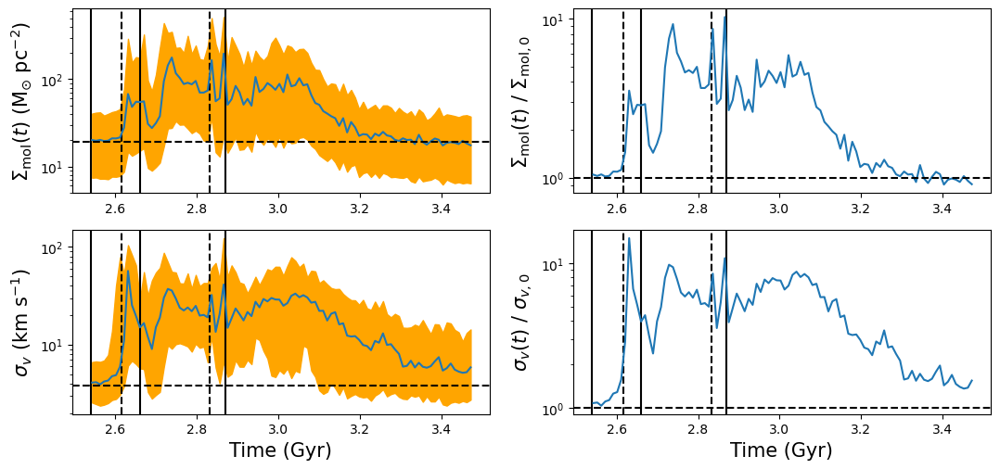

In [18]:
%matplotlib inline
Surf_meds = Dicts['Sigmol_med']
vdep_meds = Dicts['vdep_med']

# fig = plt.figure(figsize=(0.8*tex_textwidth, 0.6*tex_textwidth))
fig, axes = plt.subplots(2,2, figsize=(0.9*tex_textwidth, 0.4*tex_textwidth))
# set the yscale for all the axes to be log
for ax_row in axes:
    for ax in ax_row:
        ax.set_yscale('log')
        # plot the time for second enounter and final coalesce
        ax.axvline(2.616, linestyle='dashed', color='black')
        ax.axvline(2.832, linestyle='dashed', color='black')
        # plot the time for the 3 snapshots selected above
        ax.axvline(2.54, linestyle='solid', color='black')
        ax.axvline(2.66, linestyle='solid', color='black')
        ax.axvline(2.87, linestyle='solid', color='black')

Sigma_0 = 19.2; vdep_0 = 3.8
# first row
axes[0][0].plot(Dicts['time'], Surf_meds[:,1])
axes[0][0].fill_between(Dicts['time'], Surf_meds[:,0], Surf_meds[:,2], color='orange')
axes[0][0].set_ylabel(r'$\Sigma_{\mathrm{mol}}(t)$ (M$_{\odot}$ pc$^{-2}$)', fontsize=15)
axes[0][0].axhline(Sigma_0, linestyle='dashed',color='black')
axes[0][1].plot(Dicts['time'], Surf_meds[:,1]/Sigma_0)
axes[0][1].axhline(1.0, linestyle='dashed',color='black')
axes[0][1].set_ylabel(r'$\Sigma_{\mathrm{mol}}(t)$ / $\Sigma_{\mathrm{mol}, 0}$', fontsize=15)
# second row
axes[1][0].plot(Dicts['time'], vdep_meds[:,1])
axes[1][0].set_ylabel(r'$\sigma_v$ (km s$^{-1}$)',fontsize=15)
axes[1][0].fill_between(Dicts['time'], vdep_meds[:,0], vdep_meds[:,2], color='orange')
axes[1][0].axhline(vdep_0, linestyle='dashed',color='black')
axes[1][1].plot(Dicts['time'], vdep_meds[:,1]/vdep_0)
axes[1][1].axhline(1.0, linestyle='dashed',color='black')
axes[1][1].set_ylabel(r'$\sigma_{v}(t)$ / $\sigma_{v, 0}$', fontsize=15)

# add the xlabel
axes[1][0].set_xlabel('Time (Gyr)', fontsize=15)
axes[1][1].set_xlabel('Time (Gyr)', fontsize=15)
# plt.legend(fontsize = 15)
plt.savefig('../Figures/Sigmol_vdep_variation.pdf', bbox_inches='tight', pad_inches=0.2)

Calculate the fraction of total molelcular gas in the center

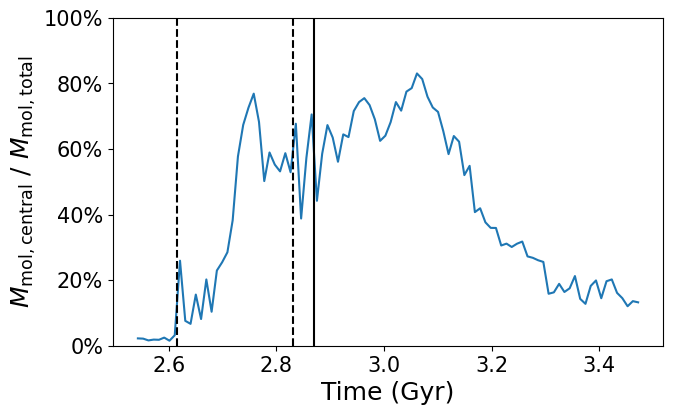

In [7]:
%matplotlib inline
Mmol_all = Dicts['Mmol']
Mmol_central = Dicts['Mmol_central']
fig = plt.figure(figsize=(0.5*tex_textwidth, 0.3*tex_textwidth))
ax = plt.subplot(111)
ax.tick_params(labelsize=15)
ax.set_ylim(top=1)
ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, 
                                                    symbol='%', 
                                                    is_latex=False))
plt.plot(Dicts['time'], Mmol_central / Mmol_all)
plt.ylabel('$M_{\mathrm{mol, central}}$ / $M_{\mathrm{mol, total}}$', fontsize=18)
plt.xlabel('Time (Gyr)', fontsize=18)
# plot the time for second enounter and final coalesce
ax.axvline(2.616, linestyle='dashed', color='black')
ax.axvline(2.831, linestyle='dashed', color='black')
# plot the 3 snapshots
# ax.axvline(2.54, linestyle='solid', color='black')
# ax.axvline(2.66, linestyle='solid', color='black')
ax.axvline(2.87, linestyle='solid', color='black')

plt.savefig('../Figures/Gas_concentration.pdf', bbox_inches='tight')

Compare the central velocity dispersion of the peak pixel and the whole aperture

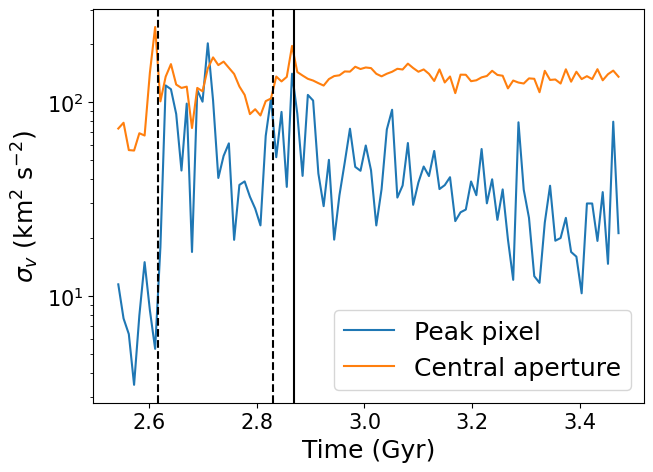

In [8]:
fig = plt.figure(figsize=(0.5*tex_textwidth, 0.36*tex_textwidth))
ax = plt.subplot(111)
ax.set_ylabel(r'$\sigma_v$ (km$^2$ s$^{-2}$)',fontsize=18)
ax.set_xlabel('Time (Gyr)', fontsize=18)
ax.tick_params(labelsize=15)
plt.yscale('log')
plt.plot(Dicts['time'], central_vdep['vdep_peak'], label='Peak pixel')
plt.plot(Dicts['time'], central_vdep['vdep_aperture'], label='Central aperture')
# plot the time for second enounter and final coalesce
ax.axvline(2.616, linestyle='dashed', color='black')
ax.axvline(2.831, linestyle='dashed', color='black')
ax.axvline(2.87, linestyle='solid', color='black')
plt.legend(loc='lower right', fontsize=18)
plt.savefig('../Figures/vdep_central.pdf', bbox_inches='tight')

Calculate the variation of the virial parameters

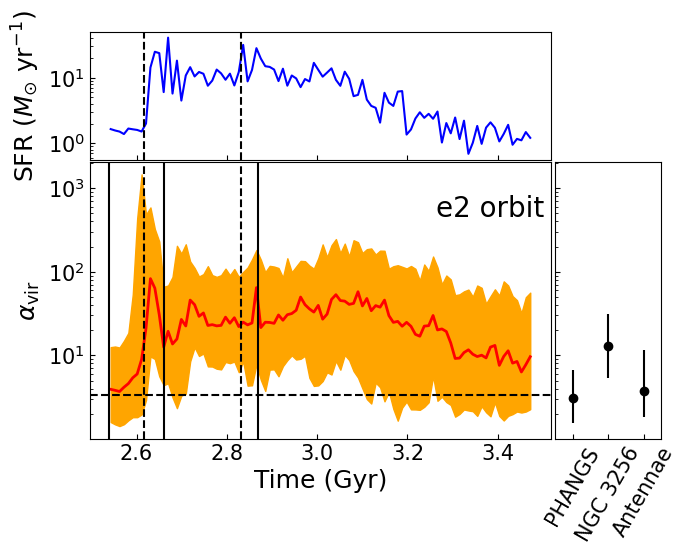

In [19]:
%matplotlib inline
# load the pickle file
filename = logDir+'G2G3_e2_v0_coalesce.pkl'
with open(filename, 'rb') as handle:
    Dicts = pickle.load(handle, encoding='latin')

# calculate the median of alphavir for all PHANGS galaxies. 
aVir_PHANGS = 5.77 * table_90pc[8]**2 * table_90pc[7]**(-1) * (45/40)**(-1)
wq = DescrStatsW(data=aVir_PHANGS, weights=table_90pc[7])
alphaVir_meds = wq.quantile(probs=[0.16, 0.5, 0.84], return_pandas=False)

# calculate the median for NGC 3256
aVir_3256 = table_3256_80pc['virial_parameter']
wq = DescrStatsW(data=aVir_3256, weights=table_3256_80pc['surface_density'])
alphaVir_3256_meds = wq.quantile(probs=[0.16, 0.5, 0.84], return_pandas=False)

# calculate the median for Antennae
aVir_ant = table_ant_90pc['virial_parameter']
wq = DescrStatsW(data=aVir_ant, weights=table_ant_90pc['surface_density'])
alphaVir_ant_meds = wq.quantile(probs=[0.16, 0.5, 0.84], return_pandas=False)

# plot alphavir as function of time
fig = plt.figure(figsize=(0.5*tex_textwidth, 0.3*tex_textwidth)) # paper
# fig = plt.figure(figsize=(9,4)) # Chile abstract
# plot layout
left, width = 0.1, 0.65
bottom, height = 0.1, 0.65
spacing = 0.005
rect_scatter = [left, bottom, width, height]
rect_histx = [left, bottom + height + spacing, width, 0.3]
rect_histy = [left + width + spacing, bottom, 0.15, height]

# plot the SFR history at the top 
ax_SFR = fig.add_axes(rect_histx)
ax_SFR.tick_params(which='both', direction='in')
ax_SFR.set_yscale('log')
ax_SFR.plot(Dicts['time'], Dicts['sfr'], color='blue')
ax_SFR.set_ylabel(r'SFR ($M_{\odot}$ yr$^{-1}$)', fontsize=18) # paper
# ax_SFR.set_ylabel(r'SFR ($M_{\odot}$ yr$^{-1}$)', fontsize=18) # abstract
# plot the time for second enounter and final coalesce
ax_SFR.axvline(2.616, linestyle='dashed', color='black')
ax_SFR.axvline(2.831, linestyle='dashed', color='black')
ax_SFR.tick_params(labelsize=15)

# central plot
ax = fig.add_axes(rect_scatter, sharex=ax_SFR)
ax_SFR.tick_params(axis="x", labelbottom=False)
ax.tick_params(which='both', direction='in')
# ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Time (Gyr)', fontsize=18)
ax.set_ylabel(r'$\alpha_{\mathrm{vir}}$', fontsize=18) # paper
# ax.set_ylabel(r'$\alpha_{\mathrm{vir}}$', fontsize=18) # abstract
# ax.set_xlim(Dicts['time'][0], Dicts['time'][-1])
# plot the alphavir
ax.plot(Dicts['time'], Dicts['alphavir_med'][:,1], color='red', linewidth=2)
ax.fill_between(Dicts['time'], Dicts['alphavir_med'][:,2], Dicts['alphavir_med'][:,0], color='orange')
# plot the time for second enounter and final coalesce
ax.axvline(2.616, linestyle='dashed', color='black')
ax.axvline(2.831, linestyle='dashed', color='black')
# plot the virial parameter baseline from isolated galaxies
aVir_0 = 3.37
ax.axhline(aVir_0, linestyle='dashed', color='black')
# annotate the plot
ax.annotate('e2 orbit',(0.75,0.8),xycoords='axes fraction',fontsize=20)
ax.tick_params(labelsize=15)

# plot the snapshot time
ax.axvline(2.54, linestyle='solid', color='black')
ax.axvline(2.66, linestyle='solid', color='black')
ax.axvline(2.87, linestyle='solid', color='black')

# right plot
ax_obs = fig.add_axes(rect_histy, sharey=ax)
ax_obs.tick_params(which='both', direction='in')
ax_obs.set_xlim(0,3)
tick_labels = ['PHANGS', 'NGC 3256', 'Antennae']
tick_values = np.array([0.5, 1.5, 2.5])
ax_obs.set_xticks(tick_values)
ax_obs.set_xticklabels(tick_labels, rotation=60, fontsize=18) # paper
# ax_obs.set_xticklabels(tick_labels, rotation=30, fontsize=18) # abstract
ax_obs.tick_params(axis="y", labelleft=False, direction='in')
alphaVirs_obs = np.vstack([alphaVir_meds, alphaVir_3256_meds, alphaVir_ant_meds])
yerrs = np.stack([alphaVirs_obs[:,1]-alphaVirs_obs[:,0], alphaVirs_obs[:,2]-alphaVirs_obs[:,1]])
plt.errorbar(tick_values, alphaVirs_obs[:,1], yerr=yerrs, color='black', linestyle='', marker='o')
ax_obs.tick_params(labelsize=15)

# fig.set_size_inches(0.8*tex_textwidth, 0.45*0.8*tex_textwidth)
fig.set_size_inches(0.5*tex_textwidth, 0.6*0.5*tex_textwidth)

plt.savefig('../Figures/G2G3_alphavir_e2.pdf', bbox_inches='tight',pad_inches=0.2)

Try the e1 orbit, which has relatively low virial parameters. 

dict_keys(['Sigmol_med', 'vdep_med', 'alphavir_med', 'sfr', 'time'])


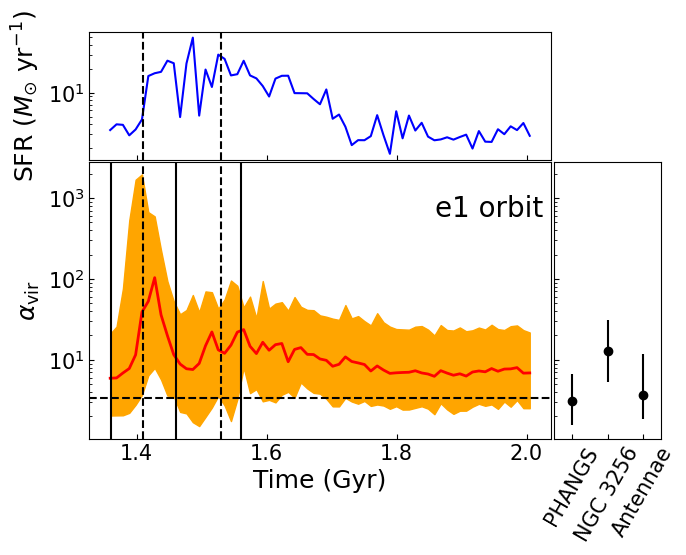

In [13]:
# load the pickle file
filename = logDir+'G2G3_e1_v0_coalesce.pkl'
with open(filename, 'rb') as handle:
    Dicts = pickle.load(handle, encoding='latin')
print(Dicts.keys())  

aVir_PHANGS = 5.77 * table_90pc[8]**2 * table_90pc[7]**(-1) * (45/40)**(-1)
wq = DescrStatsW(data=aVir_PHANGS, weights=table_90pc[7])
alphaVir_meds = wq.quantile(probs=[0.16, 0.5, 0.84], return_pandas=False)

# calculate the median for NGC 3256
aVir_3256 = table_3256_80pc['virial_parameter']
wq = DescrStatsW(data=aVir_3256, weights=table_3256_80pc['surface_density'])
alphaVir_3256_meds = wq.quantile(probs=[0.16, 0.5, 0.84], return_pandas=False)

# calculate the median for Antennae
aVir_ant = table_ant_90pc['virial_parameter']
wq = DescrStatsW(data=aVir_ant, weights=table_ant_90pc['surface_density'])
alphaVir_ant_meds = wq.quantile(probs=[0.16, 0.5, 0.84], return_pandas=False)

# plot alphavir as function of time
fig = plt.figure(figsize=(0.5*tex_textwidth, 0.3*tex_textwidth)) # paper
# fig = plt.figure(figsize=(9,4)) # Chile abstract
# plot layout
left, width = 0.1, 0.65
bottom, height = 0.1, 0.65
spacing = 0.005
rect_scatter = [left, bottom, width, height]
rect_histx = [left, bottom + height + spacing, width, 0.3]
rect_histy = [left + width + spacing, bottom, 0.15, height]

# plot the SFR history at the top 
ax_SFR = fig.add_axes(rect_histx)
ax_SFR.tick_params(which='both', direction='in')
ax_SFR.set_yscale('log')
ax_SFR.plot(Dicts['time'], Dicts['sfr'], color='blue')
ax_SFR.set_ylabel(r'SFR ($M_{\odot}$ yr$^{-1}$)', fontsize=18) # paper
# ax_SFR.set_ylabel(r'SFR ($M_{\odot}$ yr$^{-1}$)', fontsize=18) # abstract
# plot the time for second enounter and final coalesce
ax_SFR.axvline(1.41, linestyle='dashed', color='black')
ax_SFR.axvline(1.53, linestyle='dashed', color='black')
ax_SFR.tick_params(labelsize=15)

# central plot
ax = fig.add_axes(rect_scatter, sharex=ax_SFR)
ax_SFR.tick_params(axis="x", labelbottom=False)
ax.tick_params(which='both', direction='in')
# ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Time (Gyr)', fontsize=18)
ax.set_ylabel(r'$\alpha_{\mathrm{vir}}$', fontsize=18) # paper
# ax.set_ylabel(r'$\alpha_{\mathrm{vir}}$', fontsize=18) # abstract
# ax.set_xlim(Dicts['time'][0], Dicts['time'][-1])
# plot the alphavir
ax.plot(Dicts['time'], Dicts['alphavir_med'][:,1], color='red', linewidth=2)
ax.fill_between(Dicts['time'], Dicts['alphavir_med'][:,2], Dicts['alphavir_med'][:,0], color='orange')
# plot the time for second enounter and final coalesce
ax.axvline(1.41, linestyle='dashed', color='black')
ax.axvline(1.53, linestyle='dashed', color='black')
# plot the virial parameter baseline from isolated galaxies
aVir_0 = 3.37
ax.axhline(aVir_0, linestyle='dashed', color='black')
# annotate the plot
ax.annotate('e1 orbit',(0.75,0.8),xycoords='axes fraction',fontsize=20)
ax.tick_params(labelsize=15)

# plot the snapshot time
ax.axvline(1.36, linestyle='solid', color='black')
ax.axvline(1.46, linestyle='solid', color='black')
ax.axvline(1.56, linestyle='solid', color='black')

# right plot
ax_obs = fig.add_axes(rect_histy, sharey=ax)
ax_obs.tick_params(which='both', direction='in')
ax_obs.set_xlim(0,3)
tick_labels = ['PHANGS', 'NGC 3256', 'Antennae']
tick_values = np.array([0.5, 1.5, 2.5])
ax_obs.set_xticks(tick_values)
ax_obs.set_xticklabels(tick_labels, rotation=60, fontsize=18) # paper
# ax_obs.set_xticklabels(tick_labels, rotation=30, fontsize=15) # abstract
ax_obs.tick_params(axis="y", labelleft=False, direction='in')
alphaVirs_obs = np.vstack([alphaVir_meds, alphaVir_3256_meds, alphaVir_ant_meds])
yerrs = np.stack([alphaVirs_obs[:,1]-alphaVirs_obs[:,0], alphaVirs_obs[:,2]-alphaVirs_obs[:,1]])
plt.errorbar(tick_values, alphaVirs_obs[:,1], yerr=yerrs, color='black', linestyle='', marker='o')
ax_obs.tick_params(labelsize=15)

fig.set_size_inches(0.5*tex_textwidth, 0.6*0.5*tex_textwidth)

plt.savefig('../Figures/G2G3_alphavir_e1.pdf', bbox_inches='tight',pad_inches=0.2)

### Explore star formation relation

Load the central GMC pickle file

In [ ]:
# Load the pickle file for central GMCs
filename = logDir+'G2G3_e2_v0_coalesce_center.pkl'
with open(filename, 'rb') as handle:
    Dicts_center = pickle.load(handle, encoding='latin')

# load the pickle file
filename = logDir+'G2G3_e2_v0_coalesce.pkl'
with open(filename, 'rb') as handle:
    Dicts = pickle.load(handle, encoding='latin')
print(Dicts.keys())

Plot the SFR versus molecular gas color coded by virial parameters

In [ ]:
# select the time when gas concentration starts to rise to 50%
idx_50percent = np.where(Dicts['Mmol_central']/Dicts['Mmol']>0.5)[0][0]
print('Start time: '+str(np.round(Dicts['time'][idx_50percent], 2))+' Gyr')
print(idx_50percent)
print(np.where(np.round(Dicts['time'],2)==2.61)[0][0])

In [ ]:
print(np.argmax(Dicts['SFR_central'][19:96]))
print(Dicts['time'][15])

In [ ]:
from matplotlib import colors
# load the pickle file
filename = logDir+'G2G3_e2_v0_coalesce.pkl'
with open(filename, 'rb') as handle:
    Dicts = pickle.load(handle, encoding='latin')
    
fig = plt.figure(figsize=(tex_textwidth,0.3*tex_textwidth))
ax = plt.subplot(131)
plt.xlabel(r'$\Sigma_{\mathrm{mol}}$ (M$_{\odot}$ pc$^{-2}$)',fontsize=15)
plt.ylabel(r'$\Sigma_{\mathrm{SFR}}$ (M$_{\odot}$ yr$^{-1}$ kpc$^{-2}$)',fontsize=15)
plt.xscale('log')
plt.yscale('log')
sc=plt.scatter(Dicts['Mmol_central'][np.r_[0:7]]/(3.14*1e6), Dicts['SFR_central'][np.r_[0:7]]/(3.14), c=Dicts_center['alphavir_med'][np.r_[0:7],1], 
              norm=colors.LogNorm(vmin=10, vmax=110), marker='^') 
sc=plt.scatter(Dicts['Mmol_central'][np.r_[19:96]]/(3.14*1e6), Dicts['SFR_central'][np.r_[19:96]]/(3.14), c=Dicts_center['alphavir_med'][np.r_[19:96],1], 
              norm=colors.LogNorm(vmin=10, vmax=110)) 
cbaxes = inset_axes(ax, width="5%", height="50%", loc=2) 
cbar = plt.colorbar(sc, cax=cbaxes, orientation='vertical')
cbaxes.set_ylabel(r'$\alpha_{\mathrm{vir}}$', fontsize=15, loc='center', labelpad=-10)
ax.set_xlim(); ax.set_ylim()
ax.plot([1, 1e4], [1/1e1, 1e4/1e1], linestyle='dashed', color='black')
ax.plot([1, 1e4], [1/1e2, 1e4/1e2], linestyle='dashed', color='black')
ax.annotate(r'$t_{\mathrm{dep}} = 10^7$ yr', xy=(10,1.5), fontsize=15, rotation=30)
ax.annotate(r'$t_{\mathrm{dep}} = 10^8$ yr', xy=(20,0.3), fontsize=15, rotation=30)

ax = plt.subplot(132)
plt.xlabel(r'$\alpha_{\mathrm{vir}}$', fontsize=15)
plt.ylabel(r'$t_{\mathrm{dep}}$ (yr)', fontsize=15)
plt.xscale('log')
plt.yscale('log')
sc = plt.scatter(Dicts_center['alphavir_med'][np.r_[0:7],1], 
                 Dicts['Mmol_central'][np.r_[0:7]]/Dicts['SFR_central'][np.r_[0:7]], 
                 c=Dicts['time'][np.r_[0:7]],
                 vmin=2.45,vmax=3.4, marker='^')
sc = plt.scatter(Dicts_center['alphavir_med'][np.r_[19:96],1], 
                 Dicts['Mmol_central'][np.r_[19:96]]/Dicts['SFR_central'][np.r_[19:96]], 
                 c=Dicts['time'][np.r_[19:96]],
                 vmin=2.45,vmax=3.4)
cbaxes = inset_axes(ax, width="5%", height="50%", loc=3) 
cbar = plt.colorbar(sc, cax=cbaxes, orientation='vertical')
cbaxes.set_ylabel(r'Time (Gyr)', fontsize=15, loc='center', labelpad=5)
# calculate the spearman coefficient
spearman_coeff = stats.spearmanr(Dicts_center['alphavir_med'][np.r_[0:7,19:96],1], 
                                 Dicts['Mmol_central'][np.r_[0:7,19:96]]/Dicts['SFR_central'][np.r_[0:7,19:96]])
spearman_coeff_post = stats.spearmanr(Dicts_center['alphavir_med'][np.r_[19:96],1], 
                                 Dicts['Mmol_central'][np.r_[19:96]]/Dicts['SFR_central'][np.r_[19:96]])
ax.annotate('rs all: '+str(round(spearman_coeff[0], 2))+'\n'+'rs after: '+str(round(spearman_coeff_post[0], 2)), 
            xycoords='axes fraction',xy=(0.55, 0.8), fontsize=15)

ax = plt.subplot(133)
plt.xlabel(r'$\Sigma_{\mathrm{mol}}$ (M$_{\odot}$ yr$^{-1}$ pc$^{-2}$)', fontsize=15)
plt.ylabel(r'$t_{\mathrm{dep}}$ (yr)', fontsize=15)
plt.xscale('log')
plt.yscale('log')
sc = plt.scatter(Dicts['Mmol_central'][np.r_[0:7]]/3.14/1e6, 
            Dicts['Mmol_central'][np.r_[0:7]]/Dicts['SFR_central'][np.r_[0:7]], 
            c=Dicts['time'][np.r_[0:7]],
            vmin=2.45,vmax=3.4, marker='^')
sc = plt.scatter(Dicts['Mmol_central'][np.r_[19:96]]/3.14/1e6, 
            Dicts['Mmol_central'][np.r_[19:96]]/Dicts['SFR_central'][np.r_[19:96]], 
            c=Dicts['time'][np.r_[19:96]],
            vmin=2.45,vmax=3.4)
cbaxes = inset_axes(ax, width="5%", height="50%", loc=3) 
cbar = plt.colorbar(sc, cax=cbaxes, orientation='vertical')
cbaxes.set_ylabel(r'Time (Gyr)', fontsize=15, loc='center', labelpad=5)

spearman_coeff = stats.spearmanr(Dicts['Mmol_central'][np.r_[0:7,19:96]], 
                                 Dicts['Mmol_central'][np.r_[0:7,19:96]]/Dicts['SFR_central'][np.r_[0:7,19:96]])
spearman_coeff_post = stats.spearmanr(Dicts['Mmol_central'][np.r_[19:96]], 
                                 Dicts['Mmol_central'][np.r_[19:96]]/Dicts['SFR_central'][np.r_[19:96]])
ax.annotate('rs all: '+str(round(spearman_coeff[0], 2))+'\n'+'rs after: '+str(round(spearman_coeff_post[0], 2)), 
            xycoords='axes fraction',xy=(0.52, 0.8), fontsize=15)
# adjust the spacing
fig.subplots_adjust(wspace=0.27)
plt.savefig('../Figures/SFR_tdep_alphaVir.pdf', bbox_inches='tight', pad_inches=0.2)

In [ ]:
fig = plt.figure(figsize=(0.5*tex_textwidth,0.5*0.75*tex_textwidth))
ax = plt.subplot(111)
plt.yscale('log')
plt.xlabel('Time (Gyr)', fontsize=18)
plt.ylabel(r'$\alpha_{\mathrm{vir}}$', fontsize=18)
plt.plot(Dicts['time'], Dicts['alphavir_med'][:,1], label='G2&G3')
plt.plot(Dicts_center['time'], Dicts_center['alphavir_med'][:,1], label='G2&G3 center')
plt.legend(fontsize=18, loc='upper right', framealpha=0.5)
ax.tick_params(labelsize=15)

# plot the snapshot time
# ax.axvline(2.54, linestyle='solid', color='black')
# ax.axvline(2.66, linestyle='solid', color='black')
ax.axvline(2.87, linestyle='solid', color='black')
# plot the time for second enounter and final coalesce
ax.axvline(2.616, linestyle='dashed', color='black')
ax.axvline(2.831, linestyle='dashed', color='black')
plt.savefig('../Figures/G2G3_alphaVir_center.pdf', bbox_inches='tight')

Plot the freefall time vs surface density

In [ ]:
print(Dicts_center.keys())
tff_means = Dicts_center['tff_mean']

fig = plt.figure()
plt.xscale('log'); plt.yscale('log')
plt.xlabel('$\Sigma_{\mathrm{mol}}$', fontsize=15)
plt.ylabel('SFE per freefall', fontsize=15)
sc = plt.scatter(Dicts['Mmol_central'][np.r_[0:7,19:96]]/(3.14*1e6),  tff_means[np.r_[0:7,19:96]]/Dicts['Mmol_central'][np.r_[0:7,19:96]]*Dicts['SFR_central'][np.r_[0:7,19:96]])

In [ ]:
G = 6.67e-11
tff = np.sqrt(3)/(4*G)*(40*1000)/(90*2e30/3.1e16**2)/(3600*24*365)
print(tff/1e7)

#### For posters, job-application, etc. 

In [ ]:
Mmol_G2 = np.nansum(data_i2)*1e10
Mmol_G3 = np.nansum(data_i3)*1e10

Mstar_G2 = 1.2e10
Mstar_G3 = 3e10

fig = plt.figure(figsize=(tex_textwidth, 0.45*tex_textwidth))
# fig = plt.figure(figsize=(12,5))
ax0 = plt.subplot(121)
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$M_{\star}$ (M$_{\odot}$)', fontsize=15)
plt.ylabel(r'$M_{\mathrm{mol}}$ (M$_{\odot}$)', fontsize=15)
# ax0.scatter(Mstar, Mmol, color='salmon')
ax0.plot(Mstar_med, Mmol_med, marker='D', markersize=8, color='brown')
ax0.plot(Mstar_xCOLDGASS, Mmol_xCOLDGASS, marker='D', markersize=8, color='magenta')
ax0.plot(Mstar_G3, Mmol_G3, marker='*', markersize=20, linestyle='', color='blue')
ax0.plot(Mstar_G2, Mmol_G2, marker='*', markersize=20, linestyle='', color='red')
ax0.plot(M31_Mstar, M31_Mmol , marker='o', markersize=15, linestyle='', color='green')

ax1 = plt.subplot(123)
plt.xscale('log')
plt.yscale('log')
plt.xlabel(r'$M_{\star}$ (M$_{\odot}$)', fontsize=15)
plt.ylabel(r'$M_{\mathrm{mol}}$ / $M_{\star}$', fontsize=15)
# ax1.scatter(Mstar, fraction, label='PHANGS', color='salmon')
ax1.plot(Mstar_G3, Mmol_G3/Mstar_G3, marker='*', markersize=20, linestyle='', color='blue', label='FIRE G3')
ax1.plot(Mstar_G2, Mmol_G2/Mstar_G2, marker='*', markersize=20, linestyle='', color='red', label='FIRE G2')
ax1.plot(Mstar_all, MH2_all/Mstar_all, marker='*', markersize=20, linestyle='', color='green', label='FIRE G2G3')
ax1.plot(Mstar_med, fraction_med, label='PHANGS median', marker='D', markersize=8, color='brown')
ax1.plot(Mstar_xCOLDGASS, fmol_xCOLDGASS, label='xCOLDGASS median', marker='D', markersize=8, color='magenta')
ax1.plot(M31_Mstar, M31_Mmol/M31_Mstar, marker='o', markersize=15, linestyle='', color='green', label='M31')
ax1.plot(Mstar_3256, fmol_3256, marker='^', markersize=15, color='blue', label='NGC 3256', linestyle='')
ax1.plot(Mstar_40389, fmol_40389, marker='^', markersize=15, color='orange', label='Antennae', linestyle='')
# fig.legend(fontsize=12,  bbox_to_anchor=[0.98, 0.89], loc='upper center')
ax1.legend(fontsize=12, loc='lower left')
plt.savefig('../Figures/G2G3_mol_fraction_merger.pdf',bbox_inches='tight',pad_inches=0.2)